In [5]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_bboxes(image_path, bboxes, colors):
    # Load the image
    image = Image.open(image_path)

    # Create figure and axes
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(image)

    # Add bounding boxes to the image
    for bbox, color in zip(bboxes,colors):
        label, score, xmin, ymin, xmax, ymax = bbox
        width = xmax - xmin
        height = ymax - ymin

        # Create a Rectangle patch
        rect = patches.Rectangle((xmin, ymin), width, height, linewidth=1, edgecolor=color, facecolor='none')

        # Add the patch to the Axes
        ax.add_patch(rect)

        # Add label and score as text
        label_str = f"{label}: {score:.2f}"
        ax.text(xmin, ymin, label_str, color=color)

    plt.show()


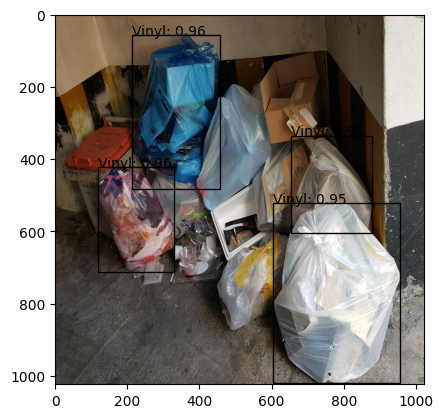

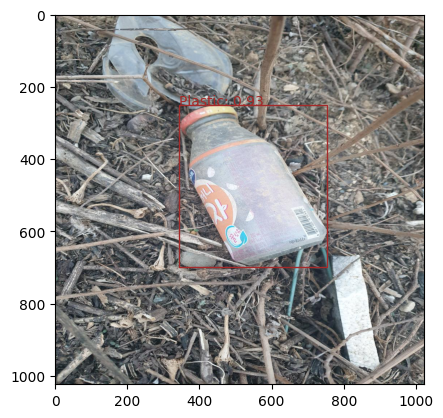

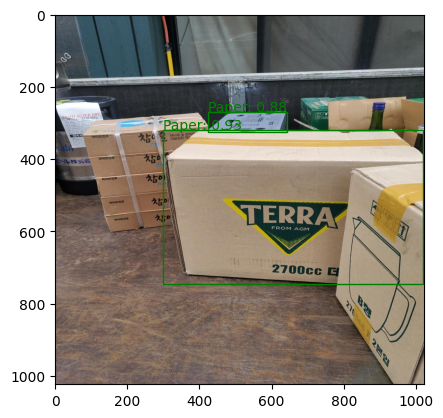

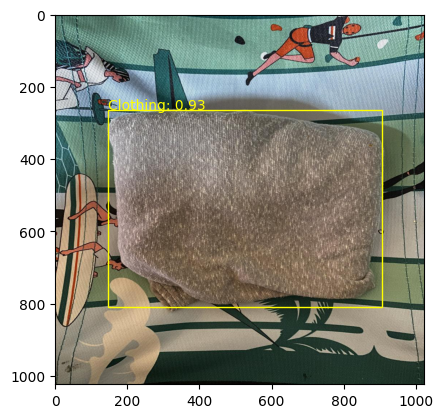

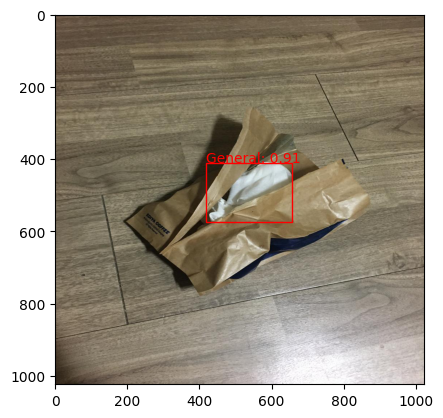

...

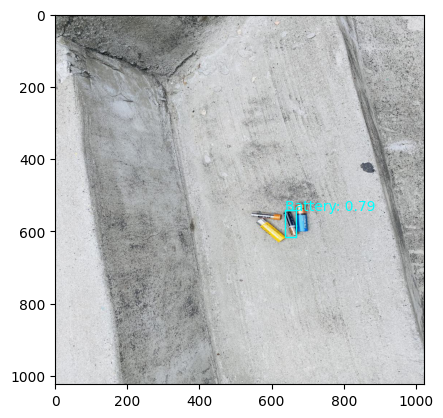

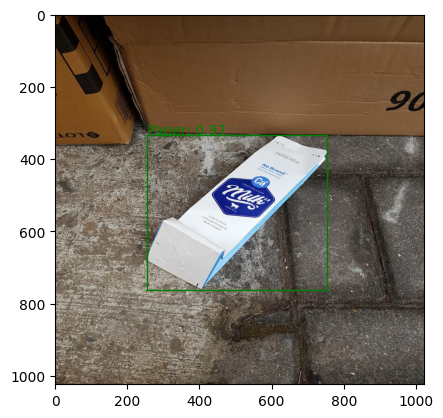

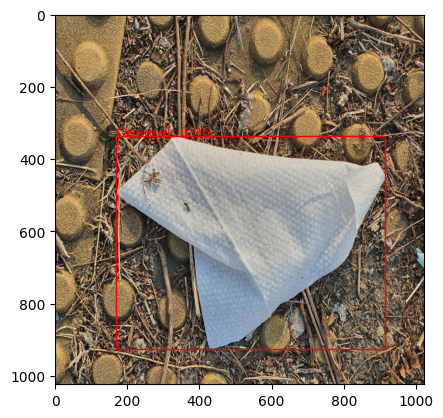

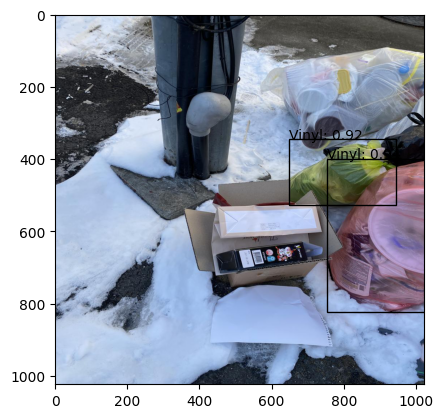

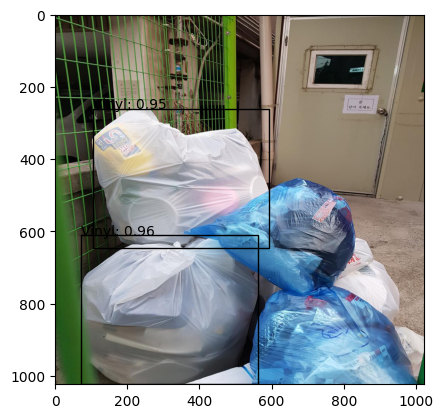

In [ ]:
import pandas as pd

# CSV 파일 경로
csv_file_path = '/data/ephemeral/home/Git/mmdetection/exp1.csv'

# CSV 파일 읽기
df = pd.read_csv(csv_file_path)

# 이미지 디렉토리 경로
image_dir = '/data/ephemeral/home/dataset'
Dict = {0:'General', 1:'Paper', 2:'PP', 3:'Metal', 4:'Glass',
                5:'Plastic', 6:'Styrofoam', 7:'Vinyl', 8:'Battery', 9:'Clothing'}
Color = {0: 'red',
        1: 'green',
        2: 'blue',
        3: 'orange',
        4: 'purple',
        5: 'brown',
        6: 'pink',
        7: 'black',
        8: 'cyan',
        9: 'yellow'}

# 이미지당 바운딩 박스 정보 시각화
for index, row in df.iterrows():
    image_id = row['image_id']
    boxes = list(map(float,row['PredictionString'].split()))
    bboxes = []
    color = []
    for i in range(0,len(boxes)//6,6):
        tmp = [Dict[int(boxes[i])],boxes[i+1],boxes[i+2],boxes[i+3],boxes[i+4],boxes[i+5]]
        bboxes.append(tmp)
        color.append(Color[int(boxes[i])])
    image_path = f"{image_dir}/{image_id}"
    visualize_bboxes(image_path, bboxes, color)
    if index == 20:
        break